In [1]:
import os
import shutil
from PIL import Image
import random
import math
import tensorflow as tf
import pathlib
from tqdm import tqdm
from matplotlib import pyplot as plt
from IPython import display

import time
import datetime
import zipfile

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt
from keras import backend

import shutil

import numpy as np
from tensorflow.keras.applications import VGG19
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg19 import preprocess_input
from sklearn.metrics.pairwise import cosine_similarity

2023-09-05 23:28:47.774301: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
SPLIT_SIZE_IMAGE = 512
IMAGE_PATH = "output/"
TRAIN_PATH = "dataset_landcover/train/"
TEST_PATH = "dataset_landcover/test/"
EVAL_PATH = "dataset_landcover/eval/"
PREPARE_DATASET = False
BATCH_SIZE = 1
BUFFER_SIZE = 400
LAMBDA = 100

In [4]:
if PREPARE_DATASET: 
    !curl -o landcover.ai.v1.zip https://landcover.ai.linuxpolska.com/download/landcover.ai.v1.zip

In [5]:
if PREPARE_DATASET: 
    # Chemin du fichier ZIP que vous avez téléchargé
    zip_file_path = "landcover.ai.v1.zip"

    # Chemin du répertoire où vous souhaitez extraire les fichiers
    extracted_folder_path = "landcover"

    # Fonction pour décompresser le fichier ZIP
    def unzip_file(zip_path, extract_path):
        with zipfile.ZipFile(zip_path, 'r') as zip_ref:
            zip_ref.extractall(extract_path)

    # Appel de la fonction pour décompresser le fichier
    unzip_file(zip_file_path, extracted_folder_path)

/usr/local/lib/python3.8/dist-packages/rasterio/__init__.py:304: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


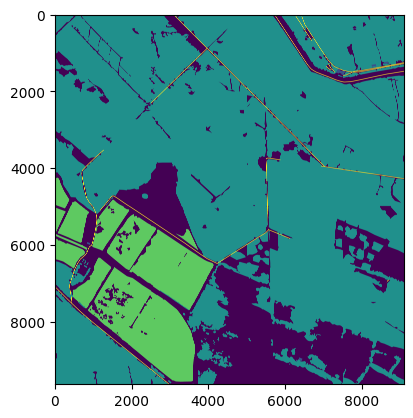

<Axes: >

In [6]:
import rasterio
from rasterio.plot import show
fp = "landcover/masks/M-33-20-D-c-4-2.tif"
img = rasterio.open(fp)
show(img)

In [7]:

if PREPARE_DATASET: 
    folder_path = 'landcover/masks'

    # Liste tous les fichiers dans le dossier spécifié
    file_list = os.listdir("landcover/masks/")

    # Affiche la liste des noms de fichiers
    for filename in file_list:
        img = rasterio.open("landcover/masks/" + filename)
        # Récupérer les dimensions de l'image
        img_width, img_height = img.width, img.height

        # Créer une nouvelle figure avec les dimensions spécifiques en pixels
        fig = plt.figure(figsize=(img_width, img_height), dpi=1)

        # Ajouter un axe à la figure
        ax = fig.add_axes([0, 0, 1, 1])
        ax.axis('off')  # Désactiver les graduations (axes)

        # Afficher l'image sur l'axe spécifié
        show(img, ax=ax)

        # Sauvegarder la figure en tant qu'image PNG
        fig.savefig("landcover/masks/" + filename, format='tiff', dpi=1)

        # Fermer la figure pour éviter l'affichage
        plt.close(fig)

In [8]:
if PREPARE_DATASET: 
    %run landcover/split.py

In [9]:
def merge_image(img1_path, img2_path, new_image_path):
    image1 = Image.open(img1_path)
    image2 = Image.open(img2_path)
    
    #resize, first image
    image1 = image1.resize((SPLIT_SIZE_IMAGE, SPLIT_SIZE_IMAGE))
    image1_size = image1.size
    image2_size = image2.size
    new_image = Image.new('RGB',(2*image1_size[0], image1_size[1]), (250,250,250))
    new_image.paste(image1,(0,0))
    new_image.paste(image2,(image1_size[0],0))
    new_image.save(new_image_path,"JPEG")

In [10]:
def create_image(from_image, to_image, new_image_name):
        merge_image(
            from_image,
            to_image,
            TRAIN_PATH + new_image_name
        )

In [11]:
if PREPARE_DATASET: 
    os.makedirs(TRAIN_PATH)
    os.makedirs(TEST_PATH)
    os.makedirs(EVAL_PATH)

In [12]:
if PREPARE_DATASET: 
    file_train = open("landcover/train.txt", 'r')
    lines = file_train.readlines()

    # Strips the newline character
    for line in tqdm(lines):
        merge_image(
            IMAGE_PATH + line.strip() + '.jpg',
            IMAGE_PATH + line.strip() + '_m.png',
            TRAIN_PATH + line.strip() + ".png"
        )

In [13]:
if PREPARE_DATASET: 
    file_train = open("landcover/val.txt", 'r')
    lines = file_train.readlines()

    # Strips the newline character
    for line in tqdm(lines):
        merge_image(
            IMAGE_PATH + line.strip() + '.jpg',
            IMAGE_PATH + line.strip() + '_m.png',
            EVAL_PATH + line.strip() + ".png"
        )

In [14]:
if PREPARE_DATASET: 
    file_train = open("landcover/test.txt", 'r')
    lines = file_train.readlines()

    # Strips the newline character
    for line in tqdm(lines):
        merge_image(
            IMAGE_PATH + line.strip() + '.jpg',
            IMAGE_PATH + line.strip() + '_m.png',
            TEST_PATH + line.strip() + ".png"
        )

(512, 1024, 3)


2023-08-27 11:27:39.269733: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:09:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-08-27 11:27:39.322259: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:09:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-08-27 11:27:39.322494: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:09:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-08-27 11:27:39.324365: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:09:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-08-27 11:27:39.324538: I tensorflow/compile

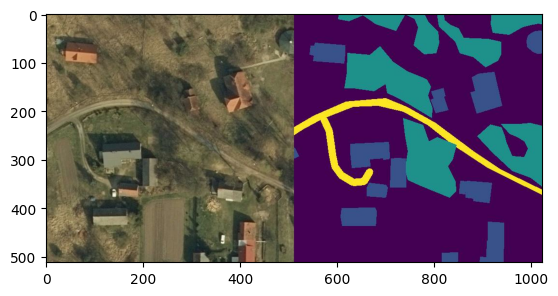

In [15]:
sample_image = tf.io.read_file(TRAIN_PATH + 'M-33-7-A-d-3-2_106.png')
sample_image = tf.io.decode_jpeg(sample_image)
print(sample_image.shape)

plt.figure()
plt.imshow(sample_image)

In [3]:
def resize(input_image, real_image, height, width):
    input_image = tf.image.resize(
        input_image,
        [height, width],
        method=tf.image.ResizeMethod.NEAREST_NEIGHBOR
    )
    real_image = tf.image.resize(
        real_image,
        [height, width],
        method=tf.image.ResizeMethod.NEAREST_NEIGHBOR
    )

    return input_image, real_image

In [4]:
DATASET_IMG_SIZE = 256
def random_crop(input_image, real_image):
    stacked_image = tf.stack([input_image, real_image], axis=0)
    cropped_image = tf.image.random_crop(
        stacked_image,
        size=[2, DATASET_IMG_SIZE, DATASET_IMG_SIZE, 3]
    )

    return cropped_image[0], cropped_image[1]

In [5]:
# Normalizing the images to [-1, 1]
def normalize(input_image, real_image):
    input_image = (input_image / 127.5) - 1
    real_image = (real_image / 127.5) - 1

    return input_image, real_image

In [6]:
@tf.function()
def random_jitter(input_image, real_image):
    # Resizing to 286x286
    input_image, real_image = resize(input_image, real_image, 286, 286)

    # Random cropping back to 256x256
    input_image, real_image = random_crop(input_image, real_image)

    if tf.random.uniform(()) > 0.5:
        # Random mirroring
        input_image = tf.image.flip_left_right(input_image)
        real_image = tf.image.flip_left_right(real_image)

    return input_image, real_image

In [7]:
def load(image_file):
    # Read and decode an image file to a uint8 tensor
    image = tf.io.read_file(image_file)
    image = tf.io.decode_jpeg(image)

    # Split each image tensor into two tensors:
    # - one with a real building facade image
    # - one with an architecture label image 
    w = tf.shape(image)[1]
    w = w // 2
    input_image = image[:, w:, :]
    real_image = image[:, :w, :]

    # Convert both images to float32 tensors
    input_image = tf.cast(input_image, tf.float32)
    real_image = tf.cast(real_image, tf.float32)

    return random_jitter(input_image, real_image)

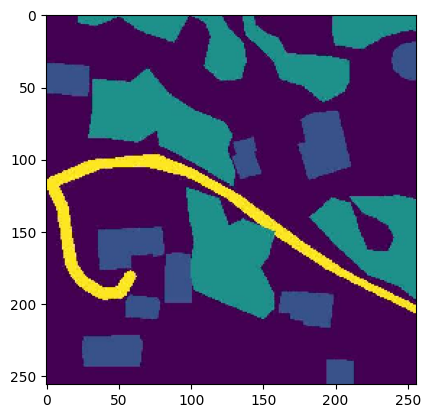

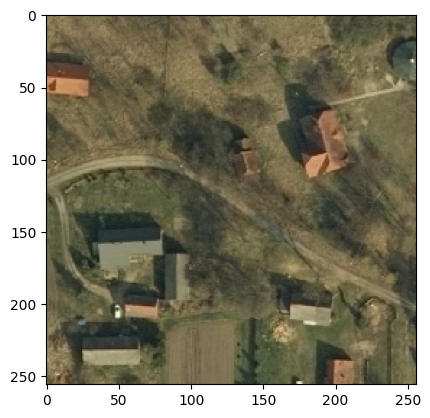

In [21]:
inp, re = load(TRAIN_PATH + 'M-33-7-A-d-3-2_106.png')
# Casting to int for matplotlib to display the images
plt.figure()
plt.imshow(inp / 255.0)
plt.figure()
plt.imshow(re / 255.0)

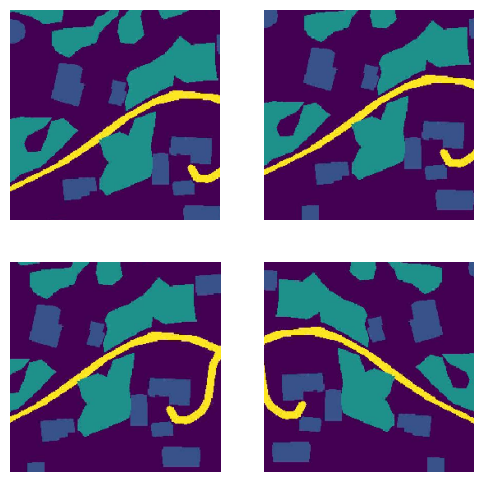

In [22]:
plt.figure(figsize=(6, 6))
for i in range(4):
    rj_inp, rj_re = random_jitter(inp, re)
    plt.subplot(2, 2, i + 1)
    plt.imshow(rj_inp / 255.0)
    plt.axis('off')
plt.show()

In [8]:
def load_image_train(image_file):
    input_image, real_image = load(image_file)
    input_image, real_image = random_jitter(input_image, real_image)
    input_image, real_image = normalize(input_image, real_image)
    return input_image, real_image

In [9]:
def load_image_test(image_file):
    input_image, real_image = load(image_file)
    input_image, real_image = resize(
        input_image,
        real_image,
        DATASET_IMG_SIZE,
        DATASET_IMG_SIZE
    )
    input_image, real_image = normalize(input_image, real_image)

    return input_image, real_image

In [10]:
train_dataset = tf.data.Dataset.list_files(TRAIN_PATH + "*.png")
train_dataset = train_dataset.map(
    load_image_train,
    num_parallel_calls=tf.data.AUTOTUNE
)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

2023-09-05 23:29:11.402344: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:09:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-09-05 23:29:11.452641: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:09:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-09-05 23:29:11.452836: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:09:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-09-05 23:29:11.454875: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:981] could not open file to read NUMA node: /sys/bus/pci/devices/0000:09:00.0/numa_node
Your kernel may have been built without NUMA support.
2023-09-05 23:29:11.455023: I tensorflow/compile

In [11]:
test_dataset = tf.data.Dataset.list_files(TEST_PATH + "*.png")
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

In [27]:
eval_dataset = tf.data.Dataset.list_files(EVAL_PATH + "*.png")
eval_dataset = eval_dataset.map(
    load_image_train,
    num_parallel_calls=tf.data.AUTOTUNE
)
eval_dataset = eval_dataset.shuffle(BUFFER_SIZE)
eval_dataset = eval_dataset.batch(BATCH_SIZE)

In [28]:
OUTPUT_CHANNELS = 3

def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2D(
            filters,
            size,
            strides=2,
            padding='same',
            kernel_initializer=initializer,
            use_bias=False
        )
    )

    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())

    result.add(tf.keras.layers.LeakyReLU())

    return result

down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print (down_result.shape)

2023-08-27 11:27:50.953000: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:432] Loaded cuDNN version 8600


(1, 128, 128, 3)


In [29]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2DTranspose(
            filters,
            size,
            strides=2,
            padding='same',
            kernel_initializer=initializer,
            use_bias=False
        )
    )

    result.add(tf.keras.layers.BatchNormalization())

    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.8))

    result.add(tf.keras.layers.ReLU())

    return result

up_model = upsample(3, 4)
up_result = up_model(down_result)
print (up_result.shape)

(1, 256, 256, 3)


In [30]:
def residual_block_down(filters, size):
    result = tf.keras.Sequential()

    result.add(tf.keras.layers.Conv2D(filters, size, strides=1, padding='same'))
    result.add(tf.keras.layers.BatchNormalization())
    result.add(tf.keras.layers.ReLU())

    result.add(tf.keras.layers.Conv2D(filters, size, strides=1, padding='same'))
    result.add(tf.keras.layers.BatchNormalization())

    def block(x):
        y = result(x)
        if x.shape[3] != y.shape[3]:  # Vérifie si les canaux sont incompatibles
            x = tf.keras.layers.Conv2D(filters, 1, strides=1, padding='same')(x)
            x = tf.keras.layers.BatchNormalization()(x)
        y = tf.keras.layers.add([x, y])  # Concaténation résiduelle
        y = tf.keras.layers.ReLU()(y)
        # Squeeze-and-Excitation (SE) block
        se = tf.keras.layers.GlobalAveragePooling2D()(y)
        se = tf.keras.layers.Dense(filters // 8, activation='relu')(se)
        se = tf.keras.layers.Dense(filters, activation='sigmoid')(se)
        se = tf.keras.layers.Reshape((1, 1, filters))(se)
        y = tf.keras.layers.Multiply()([y, se])

        return y

    return block
def residual_block_up(filters, size):
    result = tf.keras.Sequential()

    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=1, padding='same'))
    result.add(tf.keras.layers.BatchNormalization())
    result.add(tf.keras.layers.ReLU())

    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=1, padding='same'))
    result.add(tf.keras.layers.BatchNormalization())

    def block(x):
        y = result(x)
        if x.shape[3] != y.shape[3]:  # Vérifie si les canaux sont incompatibles
            x = tf.keras.layers.Conv2DTranspose(filters, 1, strides=1, padding='same')(x)
            x = tf.keras.layers.BatchNormalization()(x)
        y = tf.keras.layers.add([x, y])  # Concaténation résiduelle
        y = tf.keras.layers.ReLU()(y)
        # Squeeze-and-Excitation (SE) block
        se = tf.keras.layers.GlobalAveragePooling2D()(y)
        se = tf.keras.layers.Dense(filters // 8, activation='relu')(se)
        se = tf.keras.layers.Dense(filters, activation='sigmoid')(se)
        se = tf.keras.layers.Reshape((1, 1, filters))(se)
        y = tf.keras.layers.Multiply()([y, se])
        return y
    
    return block

In [31]:
def Generator():
    inputs = tf.keras.layers.Input(shape=[256, 256, 3])

    down_stack = [
        downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
        residual_block_down(128, 4),
        downsample(128, 4),  # (batch_size, 64, 64, 128)
        residual_block_down(256, 4),
        downsample(256, 4),  # (batch_size, 32, 32, 256)
        residual_block_down(512, 4),
        downsample(512, 4),  # (batch_size, 16, 16, 512)
        residual_block_down(512, 4),
        downsample(512, 4),  # (batch_size, 8, 8, 512)
        downsample(512, 4),  # (batch_size, 4, 4, 512)
        downsample(512, 4),  # (batch_size, 2, 2, 512)
        downsample(512, 4),  # (batch_size, 1, 1, 512)
    ]

    up_stack = [
        upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
        upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
        upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
        upsample(512, 4),  # (batch_size, 16, 16, 1024)
        residual_block_up(512, 4),
        upsample(512, 4),  # (batch_size, 32, 32, 1024)
        residual_block_up(512, 4),
        upsample(256, 4),  # (batch_size, 64, 64, 512)
        residual_block_up(256, 4),
        upsample(128, 4),  # (batch_size, 128, 128, 256)
        residual_block_up(128, 4),
    ]

    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(
        OUTPUT_CHANNELS,
        4,
        strides=2,
        padding='same',
        kernel_initializer=initializer,
        activation='tanh'
    )  # (batch_size, 256, 256, 3)

    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = tf.keras.layers.Concatenate()([x, skip])

    x = last(x)

    return tf.keras.Model(inputs=inputs, outputs=x)

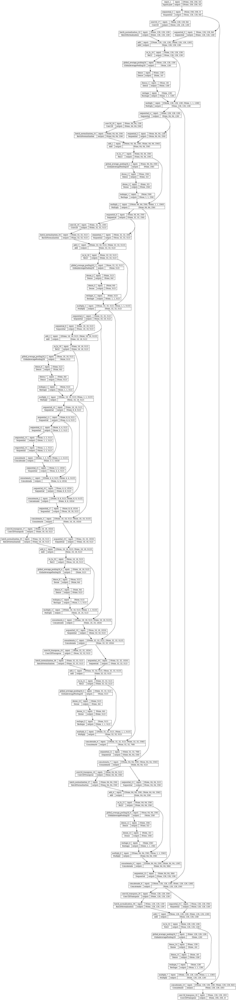

In [32]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

2023-08-27 11:27:57.209423: I tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:606] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


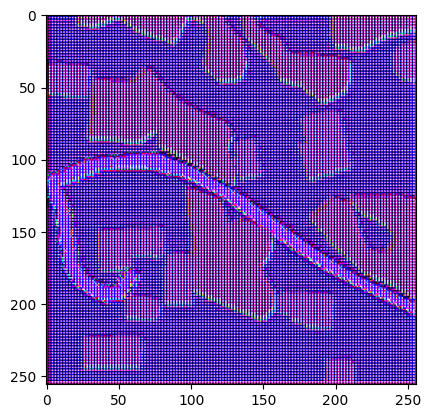

In [33]:
gen_output = generator(inp[tf.newaxis, ...], training=False)
plt.imshow(gen_output[0, ...])

In [34]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def wasserstein_loss(y_true, y_pred):
	return backend.mean(y_true * y_pred)

# def kl_divergence_loss(target, generated):
#     target_probs = target / tf.reduce_sum(target, axis=-1, keepdims=True)
#     generated_probs = generated / tf.reduce_sum(generated, axis=-1, keepdims=True)
#     return tf.reduce_mean(tf.reduce_sum(target_probs * tf.math.log(target_probs / generated_probs), axis=-1))

In [35]:
# def generator_loss(disc_generated_output, gen_output, target):
#     gan_loss = wasserstein_loss(tf.ones_like(disc_generated_output), disc_generated_output)

#     # Mean absolute error
#     l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

#     total_gen_loss = gan_loss + (LAMBDA * l1_loss)

#     return total_gen_loss, gan_loss, l1_loss

def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = -tf.reduce_mean(disc_generated_output)
    # mean absolute error
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

    total_gen_loss = gan_loss + (LAMBDA * l1_loss)

    return total_gen_loss, gan_loss, l1_loss


In [36]:
def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)

    inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
    tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

    x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

    down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
    res1 = residual_block_down(64, 4)(down1)
    down2 = downsample(128, 4)(res1)  # (batch_size, 64, 64, 128)
    res2 = residual_block_down(128, 4)(down2)
    down3 = downsample(256, 4)(res2)  # (batch_size, 32, 32, 256)
    res3 = residual_block_down(256, 4)(down3)

    zero_pad1 = tf.keras.layers.ZeroPadding2D()(res3)  # (batch_size, 34, 34, 256)
    conv = tf.keras.layers.Conv2D(
        512, 4,
        strides=1,
        kernel_initializer=initializer,
        use_bias=False
    )(zero_pad1)  # (batch_size, 31, 31, 512)
    res4 = residual_block_down(512, 4)(conv)
    batchnorm1 = tf.keras.layers.BatchNormalization()(res4)

    leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

    last = tf.keras.layers.Conv2D(
        1,
        4,
        strides=1,
        kernel_initializer=initializer
    )(zero_pad2)  # (batch_size, 30, 30, 1)

    return tf.keras.Model(inputs=[inp, tar], outputs=last)

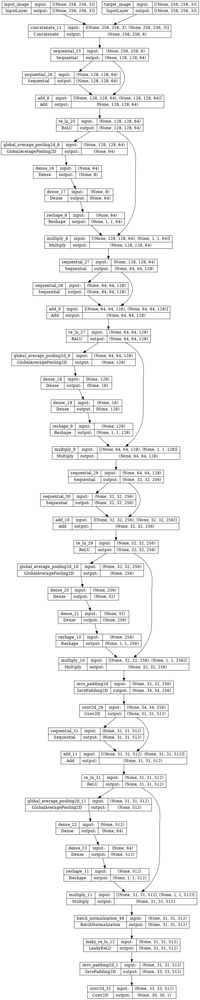

In [37]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

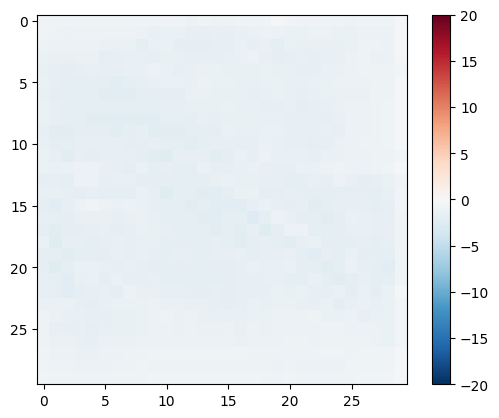

In [38]:
# print(gen_output)
disc_out = discriminator([inp[tf.newaxis, ...], gen_output], training=False)
# print(disc_out)
plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

In [39]:
# def discriminator_loss(disc_real_output, disc_generated_output):
#     # real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

#     # generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

#     # total_disc_loss = real_loss + generated_loss

#     return backend.mean(disc_generated_output) - backend.mean(disc_real_output)

#     # return total_disc_loss

def discriminator_loss(disc_real_output, disc_generated_output):
    total_disc_loss = tf.reduce_mean(disc_generated_output) - tf.reduce_mean(disc_real_output)
    
    return total_disc_loss

In [40]:
# generator_optimizer = tf.keras.optimizers.Adam(0.001, beta_1=0.5)
# discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_optimizer = tf.keras.optimizers.RMSprop(5e-5)
discriminator_optimizer = tf.keras.optimizers.RMSprop(5e-5)

In [41]:
# generator.compile(loss=generator_loss, optimizer=generator_optimizer)
# discriminator.compile(loss=discriminator_loss, optimizer=discriminator_optimizer)

In [42]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(
    generator_optimizer=generator_optimizer,
    discriminator_optimizer=discriminator_optimizer,
    generator=generator,
    discriminator=discriminator
)

In [12]:
def generate_images(model, test_input, tar):
    prediction = model(test_input, training=True)
    plt.figure(figsize=(15, 15))

    display_list = [test_input[0], tar[0], prediction[0]]
    title = ['Input Image', 'Ground Truth', 'Predicted Image']

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        # Getting the pixel values in the [0, 1] range to plot.
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')
    plt.show()

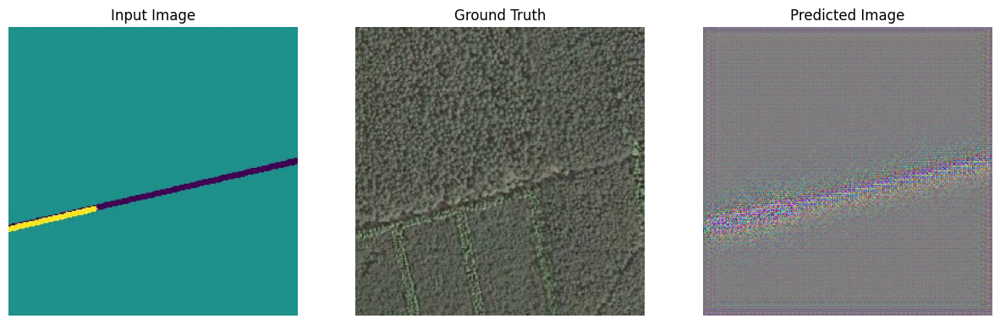

In [44]:
for example_input, example_target in test_dataset.take(1):
    generate_images(generator, example_input, example_target)

In [45]:
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
    log_dir + "fit/" + "train" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
)

summary_writer_eval = tf.summary.create_file_writer(
    log_dir + "fit/" + "eval" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
)

In [46]:
@tf.function
def train_step(input_image, target, apply_gradient = True):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = generator(input_image, training=True)

        disc_real_output = discriminator([input_image, target], training=True)
        disc_generated_output = discriminator([input_image, gen_output], training=True)

        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

    if apply_gradient:
        generator_gradients = gen_tape.gradient(gen_total_loss,
                                                generator.trainable_variables)
        discriminator_gradients = disc_tape.gradient(disc_loss,
                                                    discriminator.trainable_variables)

        for idx, grad in enumerate(discriminator_gradients):
            discriminator_gradients[idx] = tf.clip_by_value(grad, -0.01, 0.01)
            
        generator_optimizer.apply_gradients(zip(generator_gradients,
                                                generator.trainable_variables))
        discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                                    discriminator.trainable_variables))

    return gen_total_loss, gen_l1_loss, gen_gan_loss, disc_loss

    # with summary_writer.as_default():
    #     tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
    #     tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
    #     tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
    #     tf.summary.scalar('disc_loss', disc_loss, step=epoch)

In [47]:
def fit(train_ds, test_ds, eval_dataset, epoch):
    early_stop_patience = 10
    eval_gen_loss_best = -float('inf')
    # eval_dis_loss_best = float('inf')
    early_stop_counter = 0
    example_input, example_target = next(iter(test_ds.take(1)))
    start = time.time()
    for epoch in range(epoch):
        epoch_disc_loss = 0
        epoch_gen_gan_loss = 0
        epoch_gen_l1_loss = 0
        epoch_gen_total_loss = 0
        print('TRAINING RUN ...')
        for (input_image, target) in tqdm(train_ds):
            gen_total_loss, gen_l1_loss, gen_gan_loss, disc_loss = train_step(input_image, target)
            epoch_disc_loss += disc_loss
            epoch_gen_gan_loss += gen_gan_loss
            epoch_gen_l1_loss += gen_l1_loss
            epoch_gen_total_loss += gen_total_loss

        epoch_gen_total_loss /= len(train_ds) * BATCH_SIZE    
        epoch_gen_l1_loss /= len(train_ds) * BATCH_SIZE    
        epoch_gen_gan_loss /= len(train_ds) * BATCH_SIZE    
        epoch_disc_loss /= len(train_ds) * BATCH_SIZE   
        print(f"TRAIN GAN LOSS : {epoch_gen_gan_loss}")
        print(f"TRAIN L1 LOSS : {epoch_gen_l1_loss}")
        print(f"TRAIN TOTAL LOSS : {epoch_gen_total_loss}")
        print(f"TRAIN DISC LOSS : {epoch_disc_loss}")

        generate_images(generator, example_input, example_target)

        with summary_writer.as_default():
            tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
            tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
            tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
            tf.summary.scalar('disc_loss', disc_loss, step=epoch) 
        checkpoint.save(file_prefix=checkpoint_prefix)

        print('EVALUATION RUN ...')
        val_gen_total_loss = 0
        val_gen_loss = 0
        val_l1_loss = 0
        val_dis_loss = 0
        for (input_image, target) in tqdm(eval_dataset):
            gen_total_loss, gen_l1_loss, gen_gan_loss, disc_loss = train_step(input_image, target, False)
            val_gen_total_loss += gen_total_loss
            val_gen_loss += gen_gan_loss
            val_l1_loss += gen_l1_loss
            val_dis_loss += disc_loss

        val_gen_total_loss /= len(eval_dataset) * BATCH_SIZE 
        val_gen_loss /= len(eval_dataset) * BATCH_SIZE 
        val_l1_loss /= len(eval_dataset) * BATCH_SIZE 
        val_dis_loss /= len(eval_dataset) * BATCH_SIZE 

        print(f'actual gen loss: {val_gen_loss}')
        print(f'past gen loss: {eval_gen_loss_best}')
        # print(f'actual dis loss: {val_dis_loss}')
        # print(f'past dis loss: {eval_dis_loss_best}')
        if (
            val_gen_loss > eval_gen_loss_best# or 
            # val_dis_loss < eval_dis_loss_best  
        ):
            eval_gen_loss_best = val_gen_loss
            # eval_dis_loss_best = val_dis_loss
            generator.save('generator_best_t.h5')
            discriminator.save('discriminator_best_t.h5')
            early_stop_counter = 0
        else:
            early_stop_counter += 1
            if early_stop_counter >= early_stop_patience:
                # generator = tf.keras.models.load_model('generator_best.h5')
                # discriminator = tf.keras.models.load_model('discriminator_best.h5')
                print(f'Arrêt anticipé à l\'époque {epoch}')
                break
        
        with summary_writer_eval.as_default():
            tf.summary.scalar('gen_total_loss', val_gen_total_loss, step=epoch)
            tf.summary.scalar('gen_gan_loss', val_gen_loss, step=epoch)
            tf.summary.scalar('gen_l1_loss', val_l1_loss, step=epoch)
            tf.summary.scalar('disc_loss', val_dis_loss, step=epoch) 
        

TRAINING RUN ...


  0%|          | 0/7470 [00:00<?, ?it/s]2023-08-27 11:28:33.503695: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel/sequential_14/dropout/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer
2023-08-27 11:28:36.340220: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x477b8690 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-08-27 11:28:36.340258: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): NVIDIA GeForce RTX 3060 Ti, Compute Capability 8.6
2023-08-27 11:28:36.411567: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:255] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2023-08-27 11:28:36.709170: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the life

TRAIN GAN LOSS : 130.0380859375
TRAIN L1 LOSS : 0.2603430449962616
TRAIN TOTAL LOSS : 156.07237243652344
TRAIN DISC LOSS : -139.0720672607422


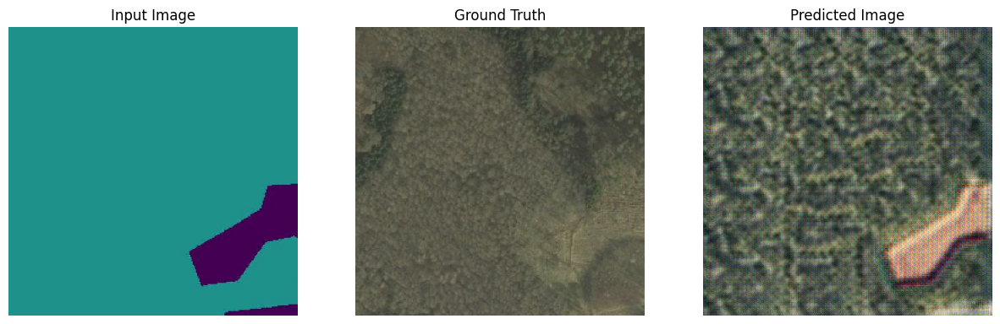

EVALUATION RUN ...


100%|██████████| 1602/1602 [01:09<00:00, 22.93it/s]


actual gen loss: 143.38290405273438
past gen loss: -inf


/usr/local/lib/python3.8/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


TRAINING RUN ...


100%|██████████| 7470/7470 [17:43<00:00,  7.03it/s]


TRAIN GAN LOSS : 620.5831298828125
TRAIN L1 LOSS : 0.26818811893463135
TRAIN TOTAL LOSS : 647.4014282226562
TRAIN DISC LOSS : -648.0223999023438


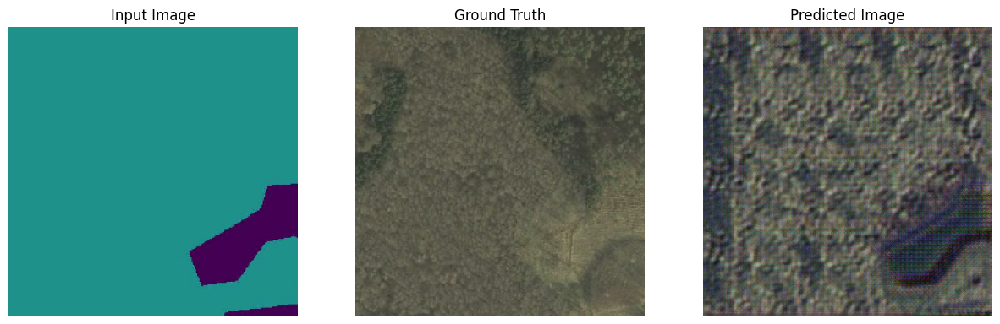

EVALUATION RUN ...


100%|██████████| 1602/1602 [01:09<00:00, 22.97it/s]


actual gen loss: -453.82977294921875
past gen loss: 143.38290405273438
TRAINING RUN ...


100%|██████████| 7470/7470 [17:23<00:00,  7.16it/s]


TRAIN GAN LOSS : 1109.4267578125
TRAIN L1 LOSS : 0.2668003737926483
TRAIN TOTAL LOSS : 1136.1070556640625
TRAIN DISC LOSS : -966.8067626953125


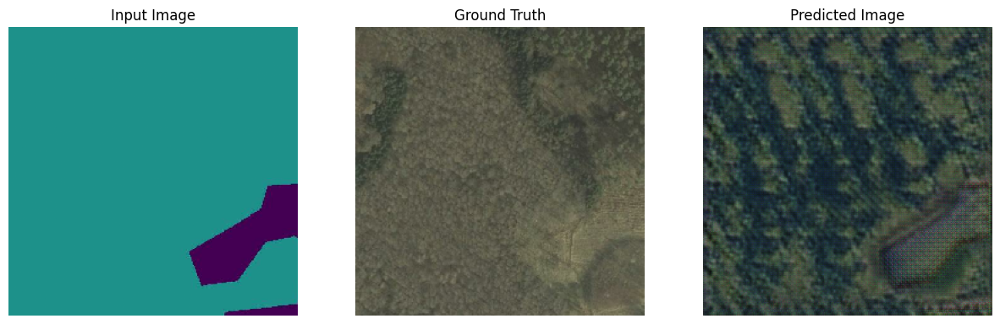

EVALUATION RUN ...


100%|██████████| 1602/1602 [01:07<00:00, 23.70it/s]

actual gen loss: 1978.830810546875
past gen loss: 143.38290405273438


TRAINING RUN ...


100%|██████████| 7470/7470 [16:59<00:00,  7.32it/s]


TRAIN GAN LOSS : 1689.18408203125
TRAIN L1 LOSS : 0.2653438150882721
TRAIN TOTAL LOSS : 1715.7178955078125
TRAIN DISC LOSS : -1431.294921875


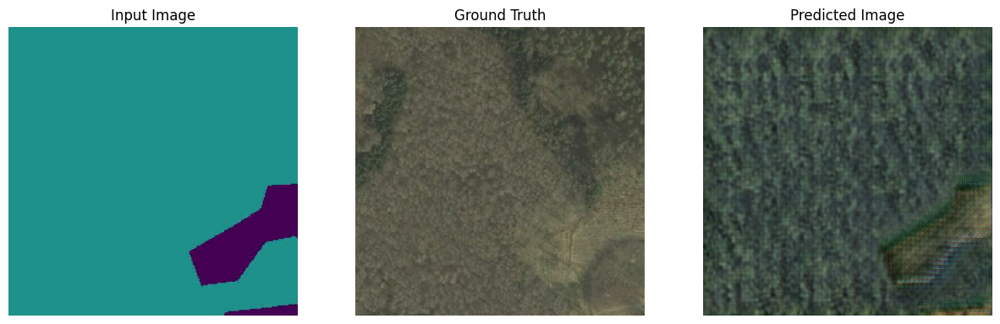

EVALUATION RUN ...


100%|██████████| 1602/1602 [01:05<00:00, 24.35it/s]

actual gen loss: 2998.299072265625
past gen loss: 1978.830810546875


TRAINING RUN ...


100%|██████████| 7470/7470 [16:46<00:00,  7.42it/s]


TRAIN GAN LOSS : 2587.99267578125
TRAIN L1 LOSS : 0.2615903615951538
TRAIN TOTAL LOSS : 2614.154296875
TRAIN DISC LOSS : -2001.5401611328125


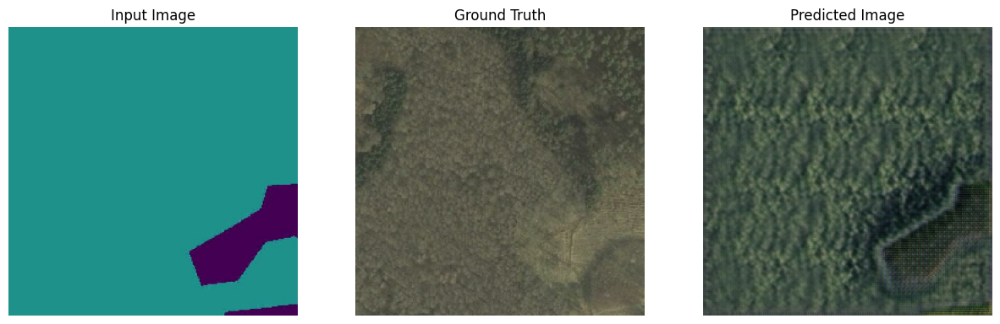

EVALUATION RUN ...


100%|██████████| 1602/1602 [01:06<00:00, 24.24it/s]

actual gen loss: 4015.826171875
past gen loss: 2998.299072265625


TRAINING RUN ...


100%|██████████| 7470/7470 [16:44<00:00,  7.43it/s]


TRAIN GAN LOSS : 3316.44580078125
TRAIN L1 LOSS : 0.2644566595554352
TRAIN TOTAL LOSS : 3342.898681640625
TRAIN DISC LOSS : -2865.35400390625


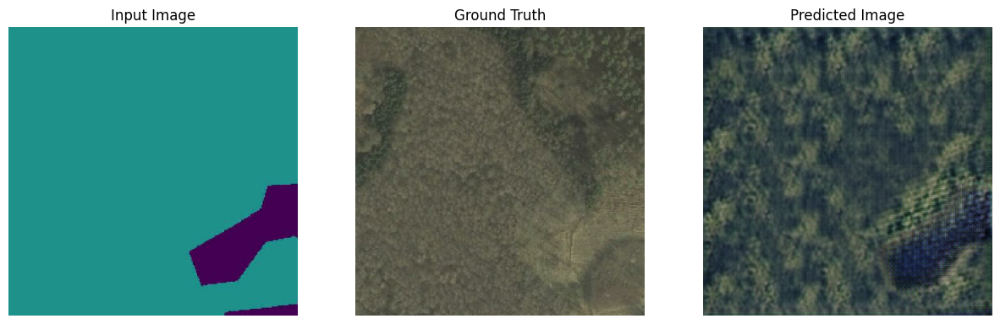

EVALUATION RUN ...


100%|██████████| 1602/1602 [01:05<00:00, 24.37it/s]

actual gen loss: 4849.5283203125
past gen loss: 4015.826171875


TRAINING RUN ...


100%|██████████| 7470/7470 [16:45<00:00,  7.43it/s]


TRAIN GAN LOSS : 4023.593017578125
TRAIN L1 LOSS : 0.26411885023117065
TRAIN TOTAL LOSS : 4050.011474609375
TRAIN DISC LOSS : -3568.285888671875


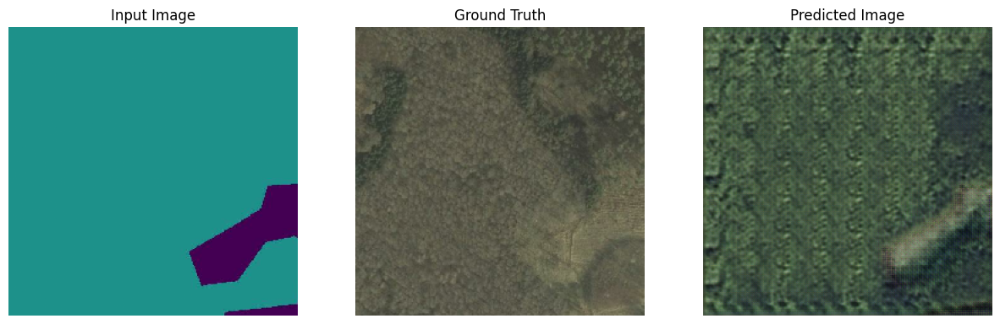

EVALUATION RUN ...


100%|██████████| 1602/1602 [01:06<00:00, 24.00it/s]

actual gen loss: 8282.01953125
past gen loss: 4849.5283203125


TRAINING RUN ...


100%|██████████| 7470/7470 [16:45<00:00,  7.43it/s]


TRAIN GAN LOSS : 4954.77392578125
TRAIN L1 LOSS : 0.26115599274635315
TRAIN TOTAL LOSS : 4980.88232421875
TRAIN DISC LOSS : -3939.419921875


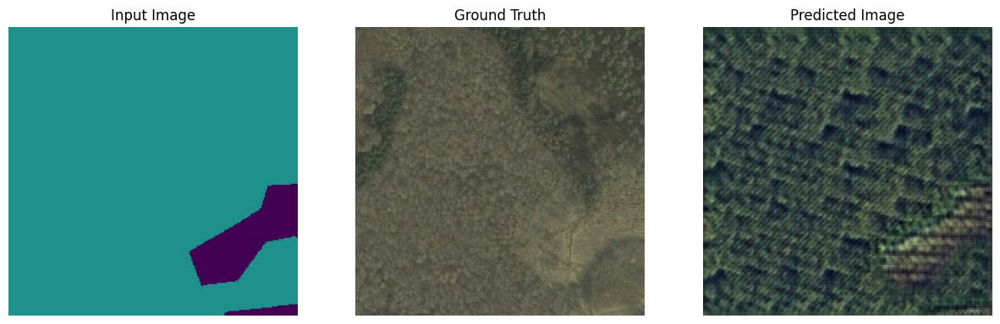

EVALUATION RUN ...


100%|██████████| 1602/1602 [01:05<00:00, 24.35it/s]

actual gen loss: 10280.921875
past gen loss: 8282.01953125


TRAINING RUN ...


100%|██████████| 7470/7470 [16:45<00:00,  7.43it/s]


TRAIN GAN LOSS : 6473.48095703125
TRAIN L1 LOSS : 0.25971993803977966
TRAIN TOTAL LOSS : 6499.447265625
TRAIN DISC LOSS : -6243.568359375


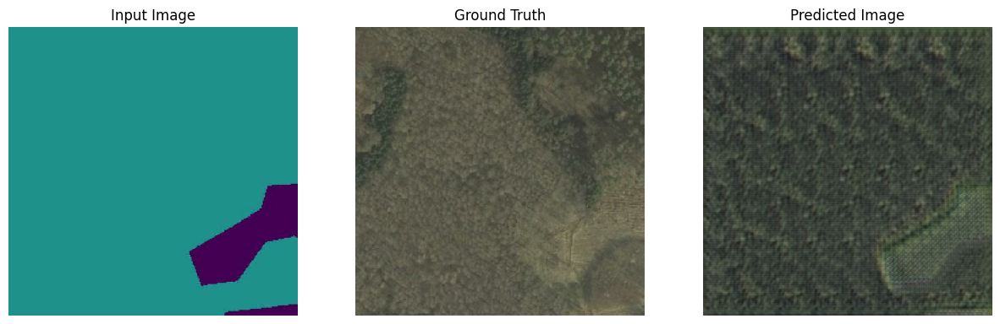

EVALUATION RUN ...


100%|██████████| 1602/1602 [01:06<00:00, 24.25it/s]


actual gen loss: 7962.498046875
past gen loss: 10280.921875
TRAINING RUN ...


100%|██████████| 7470/7470 [16:44<00:00,  7.43it/s]


TRAIN GAN LOSS : 8015.77197265625
TRAIN L1 LOSS : 0.2617432177066803
TRAIN TOTAL LOSS : 8041.94970703125
TRAIN DISC LOSS : -8543.8154296875


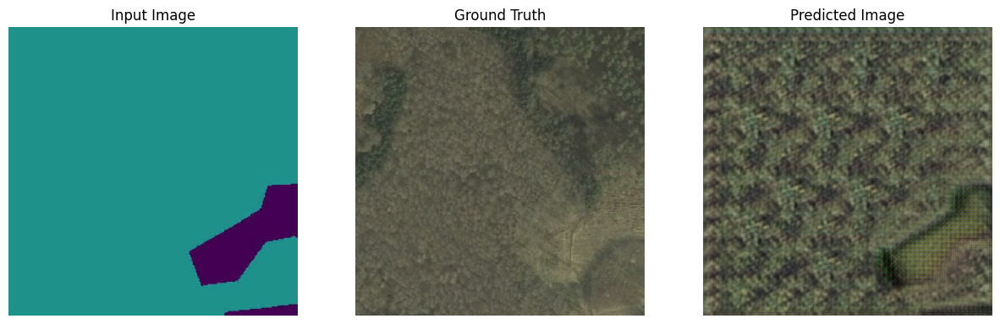

EVALUATION RUN ...


100%|██████████| 1602/1602 [01:05<00:00, 24.36it/s]


actual gen loss: 6047.72900390625
past gen loss: 10280.921875
TRAINING RUN ...


100%|██████████| 7470/7470 [16:45<00:00,  7.43it/s]


TRAIN GAN LOSS : 8884.205078125
TRAIN L1 LOSS : 0.263651967048645
TRAIN TOTAL LOSS : 8910.56640625
TRAIN DISC LOSS : -7845.71630859375


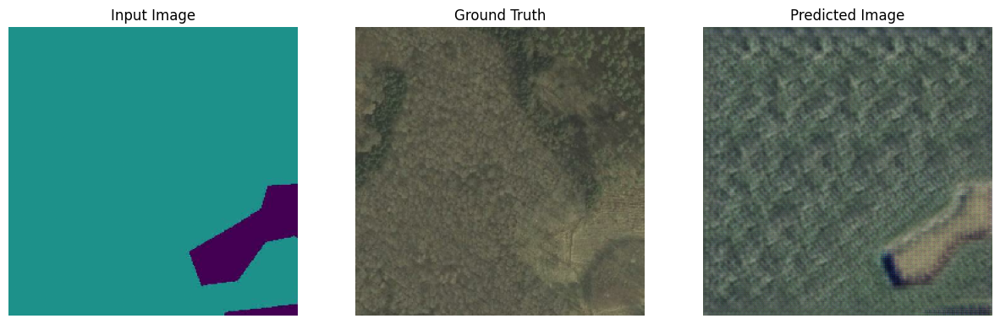

EVALUATION RUN ...


100%|██████████| 1602/1602 [01:06<00:00, 24.27it/s]

actual gen loss: 14416.1123046875
past gen loss: 10280.921875


TRAINING RUN ...


100%|██████████| 7470/7470 [16:45<00:00,  7.43it/s]


TRAIN GAN LOSS : 9634.287109375
TRAIN L1 LOSS : 0.26253217458724976
TRAIN TOTAL LOSS : 9660.5400390625
TRAIN DISC LOSS : -8319.16796875


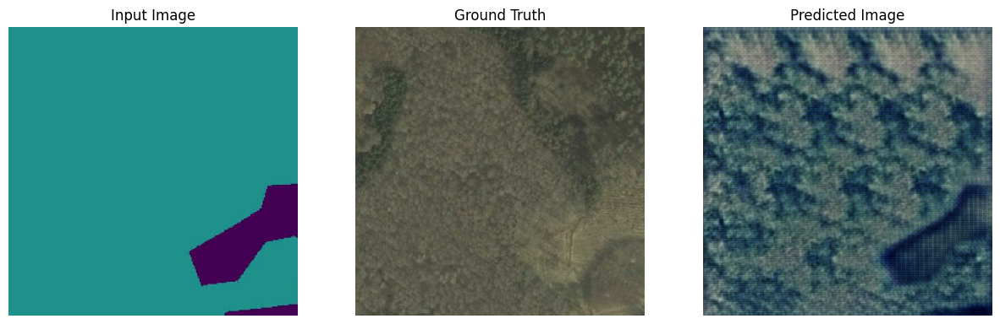

EVALUATION RUN ...


100%|██████████| 1602/1602 [01:05<00:00, 24.33it/s]


actual gen loss: 8763.310546875
past gen loss: 14416.1123046875
TRAINING RUN ...


100%|██████████| 7470/7470 [16:44<00:00,  7.43it/s]


TRAIN GAN LOSS : 10554.259765625
TRAIN L1 LOSS : 0.2635287940502167
TRAIN TOTAL LOSS : 10580.6162109375
TRAIN DISC LOSS : -7791.4169921875


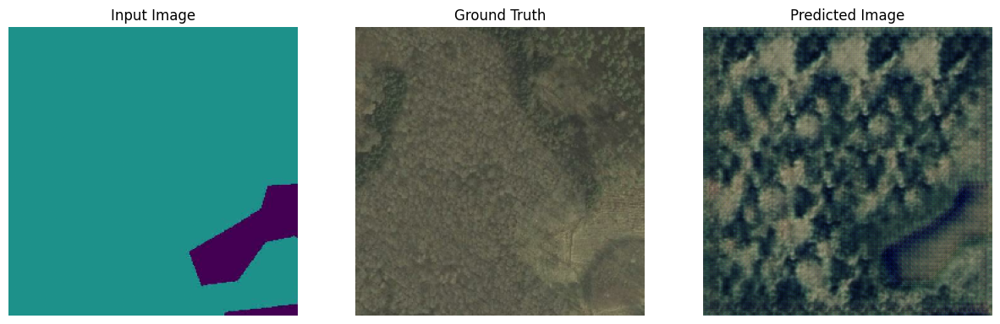

EVALUATION RUN ...


100%|██████████| 1602/1602 [01:06<00:00, 24.25it/s]


actual gen loss: 11931.6181640625
past gen loss: 14416.1123046875
TRAINING RUN ...


100%|██████████| 7470/7470 [27:16<00:00,  4.56it/s]


TRAIN GAN LOSS : 12987.810546875
TRAIN L1 LOSS : 0.2598993182182312
TRAIN TOTAL LOSS : 13013.759765625
TRAIN DISC LOSS : -10415.2841796875


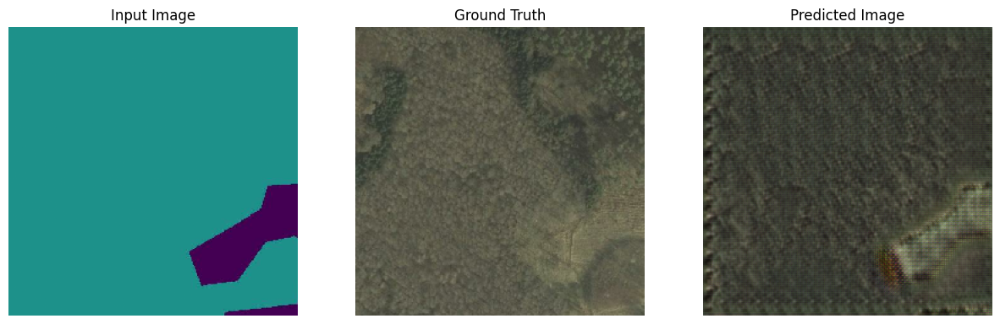

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:10<00:00, 12.30it/s]


actual gen loss: 24343.724609375
past gen loss: 14416.1123046875
TRAINING RUN ...


100%|██████████| 7470/7470 [32:53<00:00,  3.79it/s]


TRAIN GAN LOSS : 15793.3583984375
TRAIN L1 LOSS : 0.2561299502849579
TRAIN TOTAL LOSS : 15818.994140625
TRAIN DISC LOSS : -13635.974609375


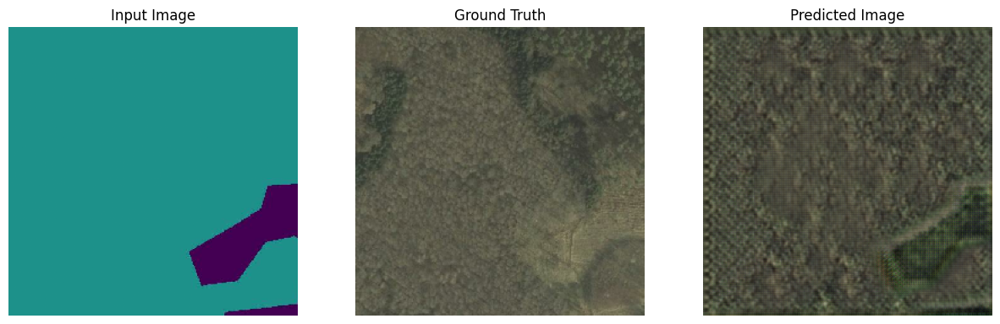

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:08<00:00, 12.44it/s]


actual gen loss: 24151.46875
past gen loss: 24343.724609375
TRAINING RUN ...


100%|██████████| 7470/7470 [33:46<00:00,  3.69it/s]


TRAIN GAN LOSS : 16628.3515625
TRAIN L1 LOSS : 0.2595168352127075
TRAIN TOTAL LOSS : 16654.2890625
TRAIN DISC LOSS : -14472.962890625


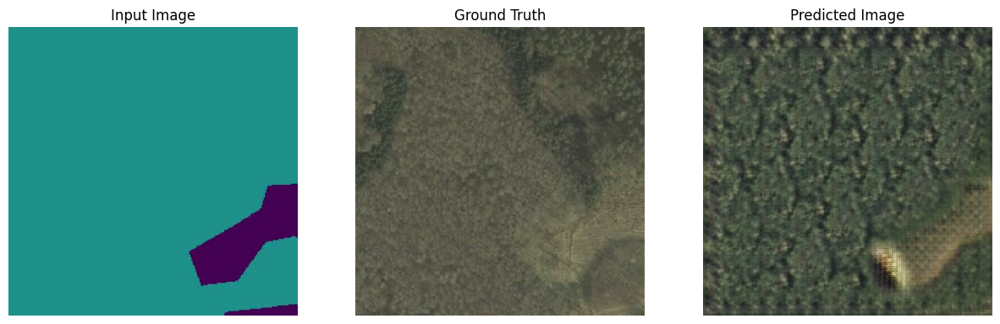

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:16<00:00, 11.76it/s]


actual gen loss: 21223.44140625
past gen loss: 24343.724609375
TRAINING RUN ...


100%|██████████| 7470/7470 [34:44<00:00,  3.58it/s]


TRAIN GAN LOSS : 15018.0712890625
TRAIN L1 LOSS : 0.2558867931365967
TRAIN TOTAL LOSS : 15043.615234375
TRAIN DISC LOSS : -12626.5966796875


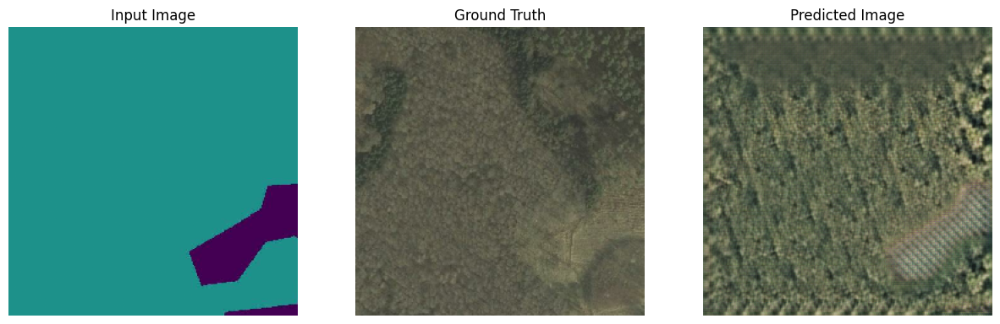

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:18<00:00, 11.59it/s]


actual gen loss: -7725.8740234375
past gen loss: 24343.724609375
TRAINING RUN ...


100%|██████████| 7470/7470 [35:04<00:00,  3.55it/s]


TRAIN GAN LOSS : 16784.138671875
TRAIN L1 LOSS : 0.25818783044815063
TRAIN TOTAL LOSS : 16809.958984375
TRAIN DISC LOSS : -13400.16015625


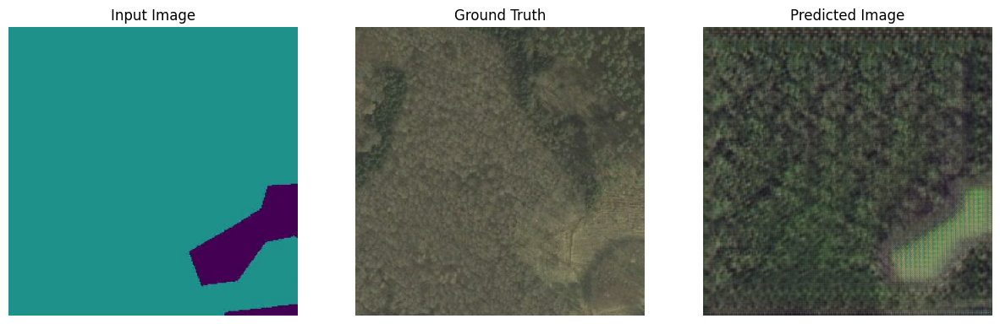

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:17<00:00, 11.65it/s]

actual gen loss: 27859.54296875
past gen loss: 24343.724609375


TRAINING RUN ...


100%|██████████| 7470/7470 [34:46<00:00,  3.58it/s]


TRAIN GAN LOSS : 19361.216796875
TRAIN L1 LOSS : 0.2568739354610443
TRAIN TOTAL LOSS : 19386.9296875
TRAIN DISC LOSS : -15972.0595703125


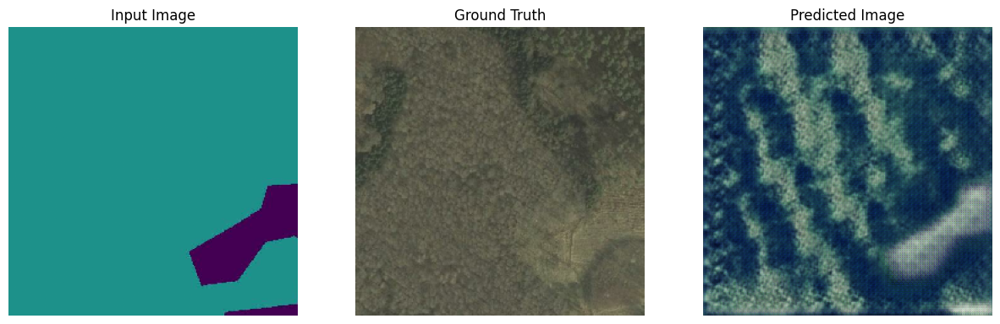

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:16<00:00, 11.75it/s]


actual gen loss: 31428.736328125
past gen loss: 27859.54296875
TRAINING RUN ...


100%|██████████| 7470/7470 [34:48<00:00,  3.58it/s]


TRAIN GAN LOSS : 20813.1953125
TRAIN L1 LOSS : 0.25868406891822815
TRAIN TOTAL LOSS : 20839.115234375
TRAIN DISC LOSS : -17022.421875


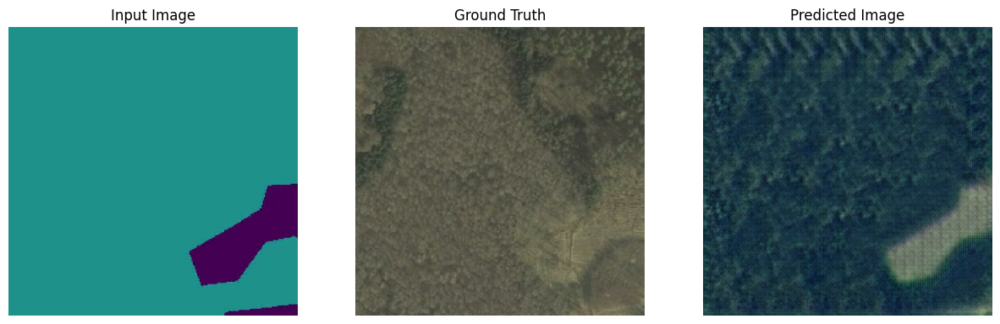

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:16<00:00, 11.76it/s]


actual gen loss: 33195.609375
past gen loss: 31428.736328125
TRAINING RUN ...


100%|██████████| 7470/7470 [34:48<00:00,  3.58it/s]


TRAIN GAN LOSS : 25552.66796875
TRAIN L1 LOSS : 0.2605332136154175
TRAIN TOTAL LOSS : 25578.662109375
TRAIN DISC LOSS : -21305.736328125


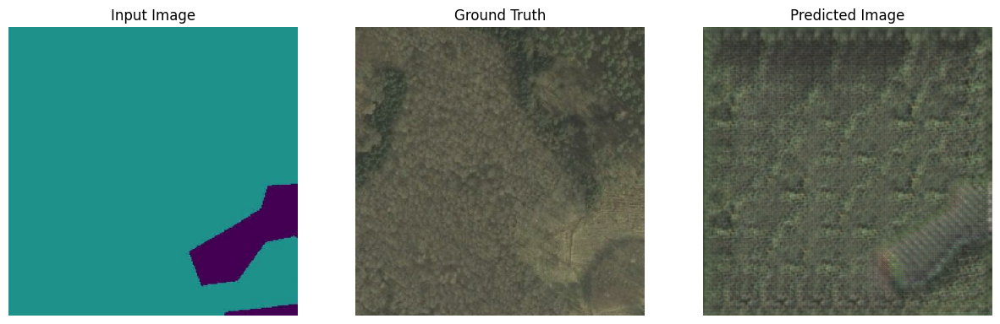

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:16<00:00, 11.75it/s]


actual gen loss: 50562.52734375
past gen loss: 33195.609375
TRAINING RUN ...


100%|██████████| 7470/7470 [34:46<00:00,  3.58it/s]


TRAIN GAN LOSS : 24724.41015625
TRAIN L1 LOSS : 0.26099294424057007
TRAIN TOTAL LOSS : 24750.568359375
TRAIN DISC LOSS : -19981.279296875


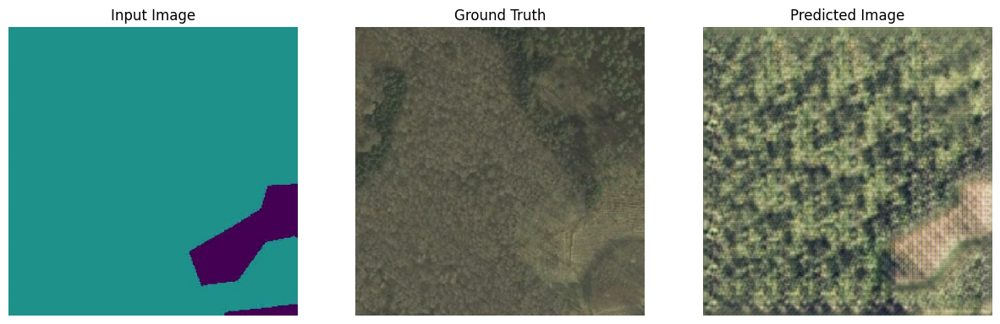

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:18<00:00, 11.58it/s]


actual gen loss: 49105.04296875
past gen loss: 50562.52734375
TRAINING RUN ...


100%|██████████| 7470/7470 [34:49<00:00,  3.57it/s]


TRAIN GAN LOSS : 24011.443359375
TRAIN L1 LOSS : 0.26339226961135864
TRAIN TOTAL LOSS : 24037.73046875
TRAIN DISC LOSS : -21010.98828125


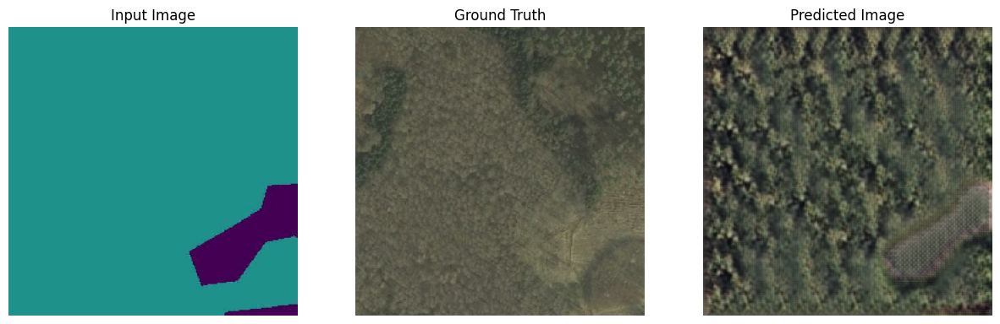

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:17<00:00, 11.63it/s]


actual gen loss: 28108.16015625
past gen loss: 50562.52734375
TRAINING RUN ...


100%|██████████| 7470/7470 [34:44<00:00,  3.58it/s]


TRAIN GAN LOSS : 34681.25
TRAIN L1 LOSS : 0.26009756326675415
TRAIN TOTAL LOSS : 34707.2421875
TRAIN DISC LOSS : -30994.99609375


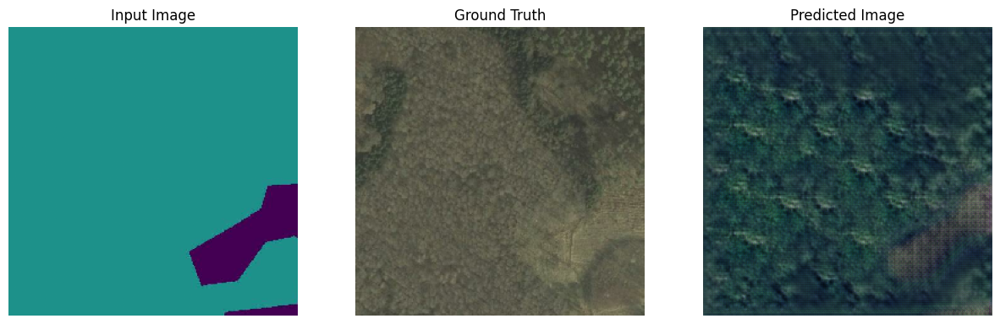

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:16<00:00, 11.71it/s]


actual gen loss: 26394.029296875
past gen loss: 50562.52734375
TRAINING RUN ...


100%|██████████| 7470/7470 [34:53<00:00,  3.57it/s]


TRAIN GAN LOSS : 30098.99609375
TRAIN L1 LOSS : 0.2585950791835785
TRAIN TOTAL LOSS : 30124.826171875
TRAIN DISC LOSS : -26697.587890625


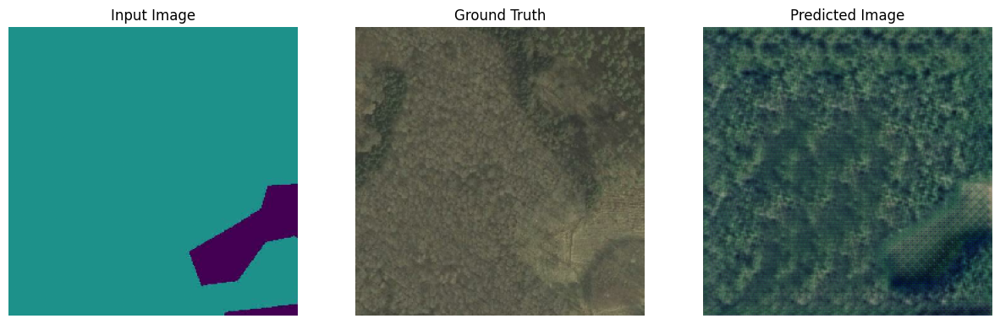

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:17<00:00, 11.65it/s]


actual gen loss: 43136.265625
past gen loss: 50562.52734375
TRAINING RUN ...


100%|██████████| 7470/7470 [35:05<00:00,  3.55it/s]


TRAIN GAN LOSS : 29104.623046875
TRAIN L1 LOSS : 0.259845107793808
TRAIN TOTAL LOSS : 29130.66015625
TRAIN DISC LOSS : -22697.083984375


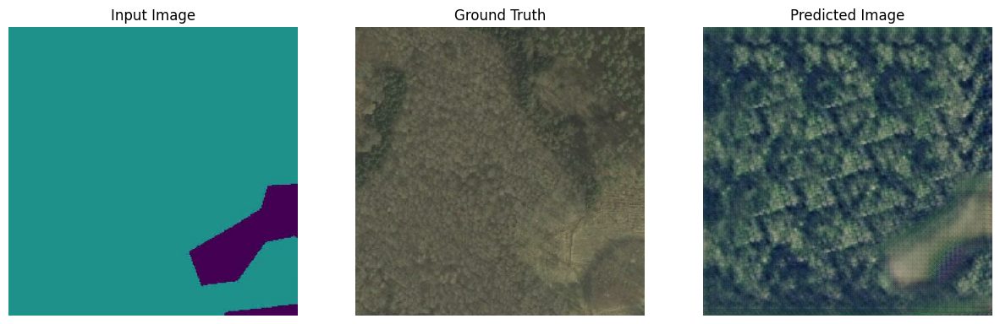

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:17<00:00, 11.65it/s]


actual gen loss: 50898.765625
past gen loss: 50562.52734375
TRAINING RUN ...


100%|██████████| 7470/7470 [34:58<00:00,  3.56it/s]


TRAIN GAN LOSS : 35946.078125
TRAIN L1 LOSS : 0.26188650727272034
TRAIN TOTAL LOSS : 35972.2734375
TRAIN DISC LOSS : -27000.619140625


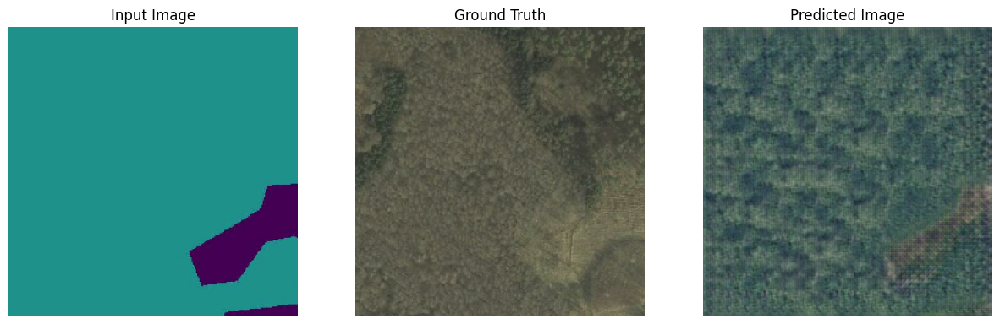

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:17<00:00, 11.66it/s]


actual gen loss: -28261.033203125
past gen loss: 50898.765625
TRAINING RUN ...


100%|██████████| 7470/7470 [34:57<00:00,  3.56it/s]


TRAIN GAN LOSS : 36918.75
TRAIN L1 LOSS : 0.2569453716278076
TRAIN TOTAL LOSS : 36944.5
TRAIN DISC LOSS : -31243.615234375


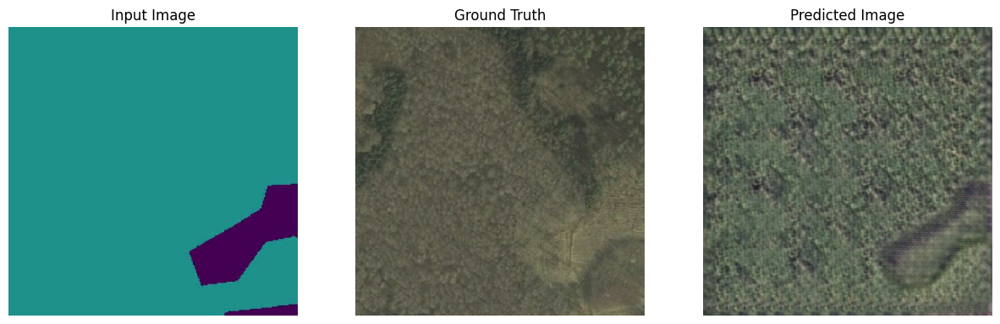

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:17<00:00, 11.64it/s]


actual gen loss: 54700.66796875
past gen loss: 50898.765625
TRAINING RUN ...


100%|██████████| 7470/7470 [34:59<00:00,  3.56it/s] 


TRAIN GAN LOSS : 51141.26953125
TRAIN L1 LOSS : 0.2600671648979187
TRAIN TOTAL LOSS : 51167.234375
TRAIN DISC LOSS : -53508.44921875


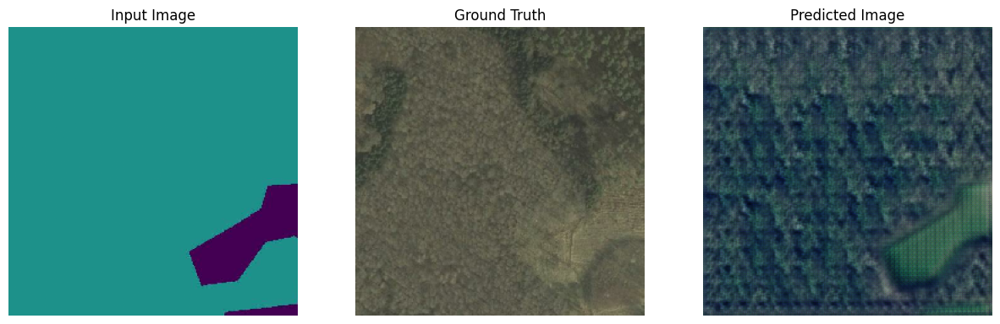

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:17<00:00, 11.66it/s]


actual gen loss: -7987.6259765625
past gen loss: 54700.66796875
TRAINING RUN ...


100%|██████████| 7470/7470 [34:55<00:00,  3.56it/s]


TRAIN GAN LOSS : 46840.765625
TRAIN L1 LOSS : 0.25940820574760437
TRAIN TOTAL LOSS : 46866.61328125
TRAIN DISC LOSS : -44060.9296875


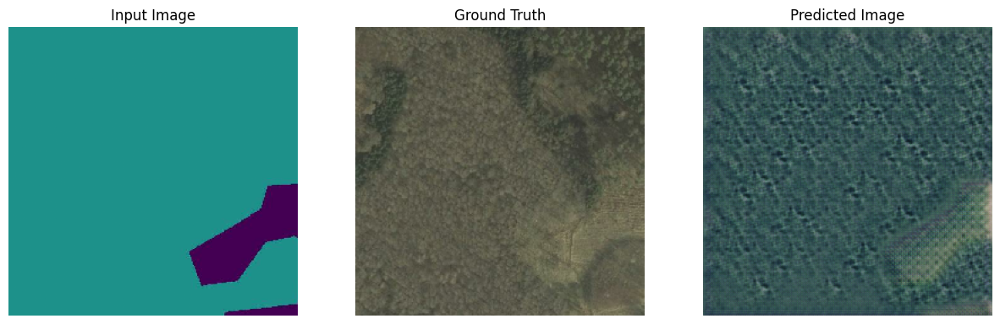

EVALUATION RUN ...


100%|██████████| 1602/1602 [02:18<00:00, 11.56it/s]


actual gen loss: 41862.12109375
past gen loss: 54700.66796875


In [48]:
fit(train_dataset, test_dataset, eval_dataset, epoch=30)
generator = tf.keras.models.load_model('generator_best_t.h5')
discriminator = tf.keras.models.load_model('discriminator_best_t.h5')

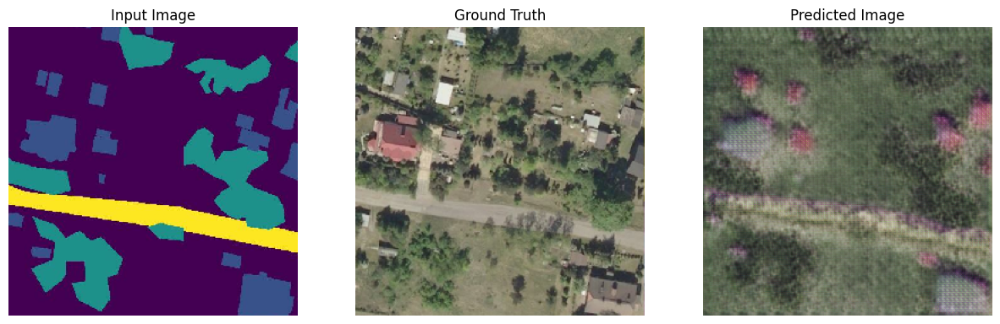

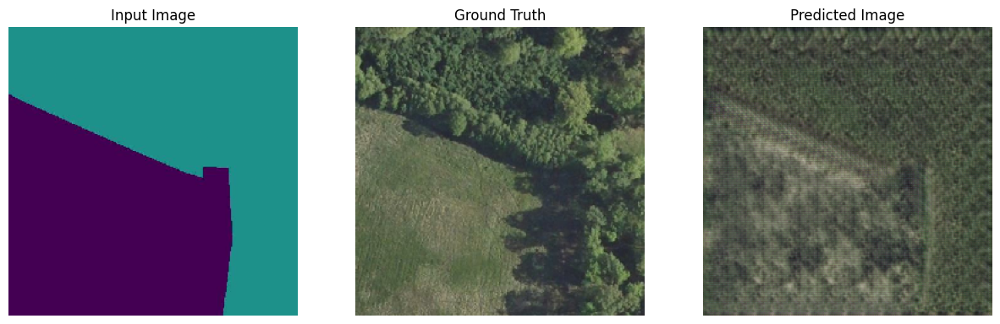

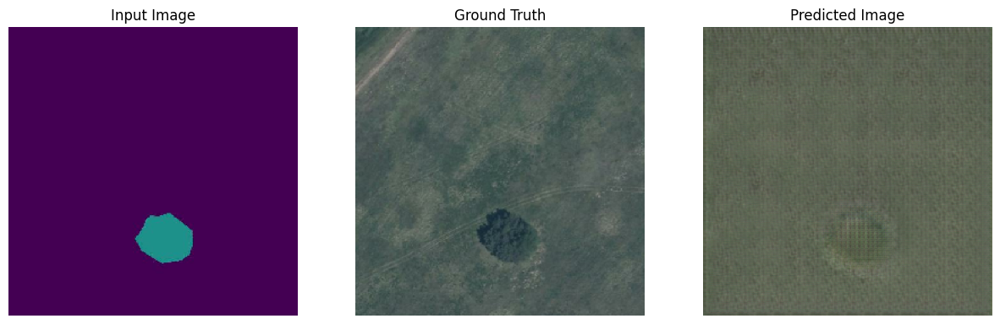

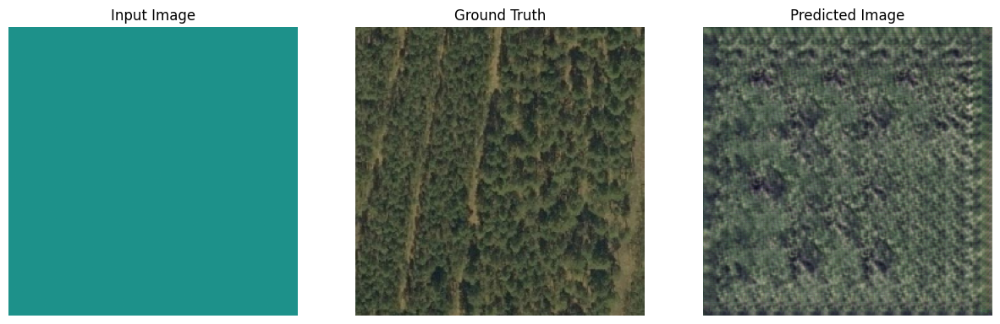

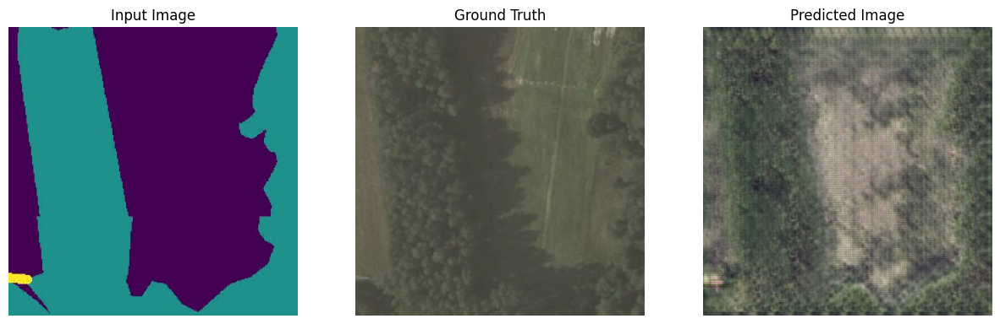

...

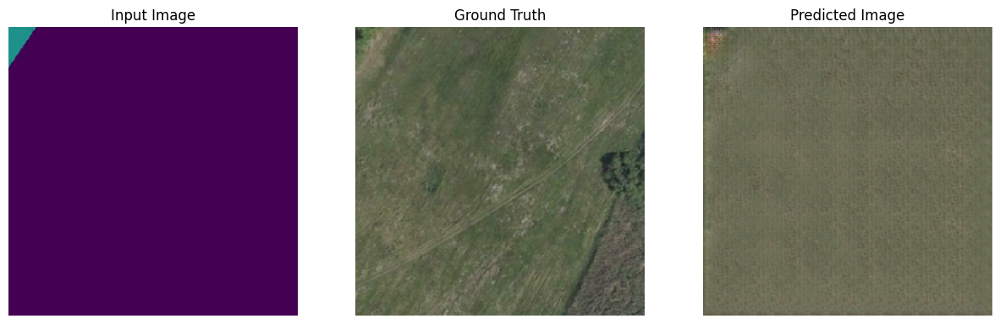

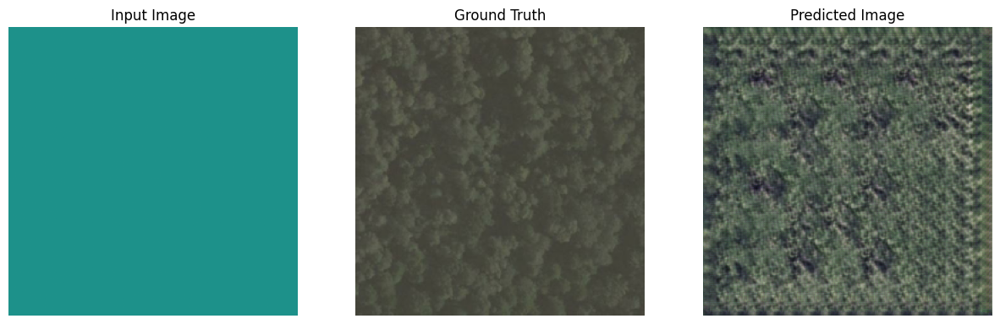

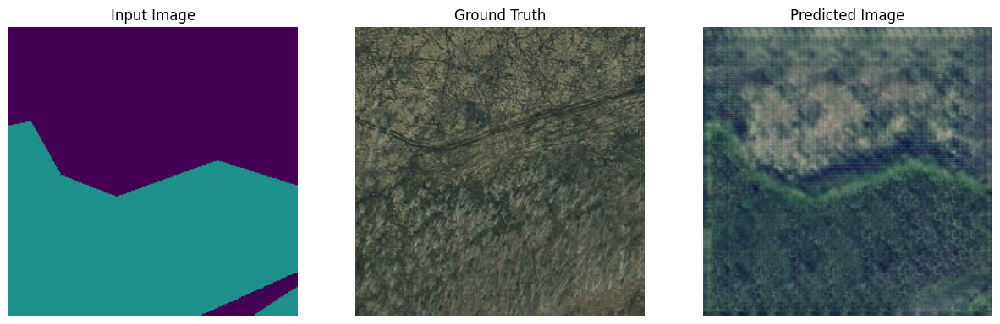

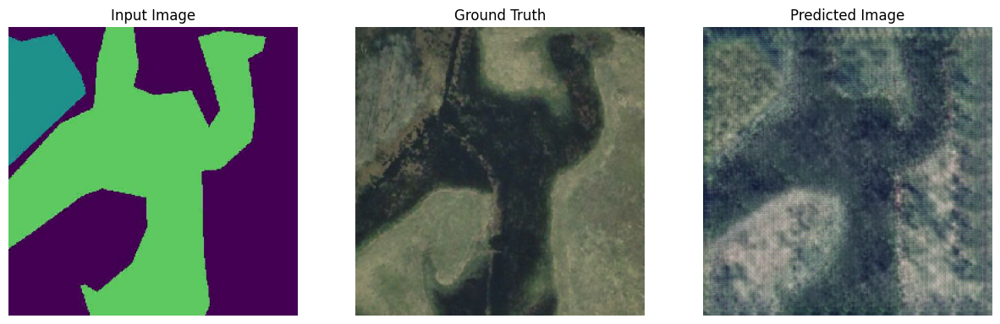

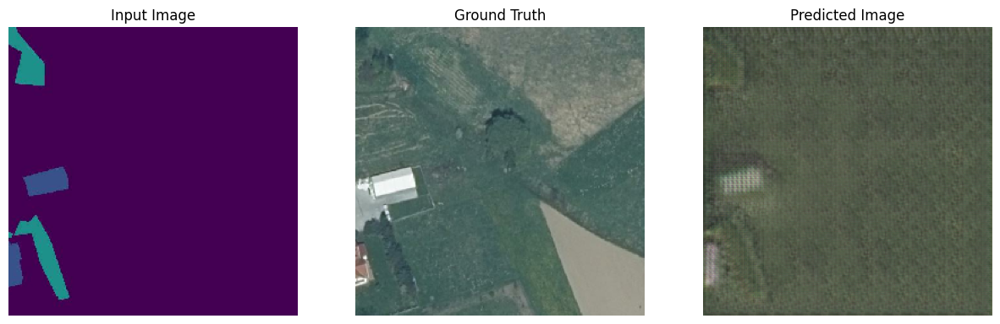

In [26]:
# Run the trained model on a few examples from the test set
for inp, tar in test_dataset.take(20):
    generate_images(generator, inp, tar)

In [52]:
display.IFrame(
    src="http://127.0.0.1:6006",
    width="100%",
    height="1000px")

In [13]:
generator = tf.keras.models.load_model('generator_best_t.h5')
discriminator = tf.keras.models.load_model('discriminator_best_t.h5')

In [15]:
base_model = VGG19(weights='imagenet', include_top=False)
base_model.trainable = False
model = Model(inputs=base_model.input, outputs=base_model.get_layer('block4_conv4').output)


def load_and_preprocess_image(image_array):
    img_array = tf.image.resize(image_array, (224, 224))
    img_array = np.array(img_array)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = preprocess_input(img_array)
    return img_array

cos_similarite = 0
distance_l1 = 0
distance_l2 = 0
for (input_image, target) in tqdm(test_dataset):
    prediction = generator(input_image, training=True)
    preprocess_predi = load_and_preprocess_image(prediction[0].numpy())
    preprocess_tar = load_and_preprocess_image(target[0].numpy())

    feature_maps_predi = model.predict(preprocess_predi, verbose=0)
    feature_maps_tar = model.predict(preprocess_tar, verbose=0)

    feature_vector_predi = feature_maps_predi.flatten()
    feature_vector_tar = feature_maps_tar.flatten()

    cos_similarite += cosine_similarity([feature_vector_predi], [feature_vector_tar])[0][0]
    distance_l1 += np.sum(np.abs(prediction[0].numpy() - target[0].numpy()))
    distance_l2 += np.sqrt(np.sum((prediction[0].numpy() - target[0].numpy()) ** 2))

print("Similarité cosinus moyenne entre les deux images:", cos_similarite / len(test_dataset))
print("Distance L1 moyenne entre les vecteurs de caractéristiques:", distance_l1 / len(test_dataset))
print("Distance L2 moyenne entre les vecteurs de caractéristiques:", distance_l2 / len(test_dataset))



100%|██████████| 1602/1602 [04:52<00:00,  5.47it/s]

Similarité cosinus moyenne entre les deux images: 0.998516129494904
Distance L1 moyenne entre les vecteurs de caractéristiques: 45235.23061322273
Distance L2 moyenne entre les vecteurs de caractéristiques: 125.17565315879983
